In [1]:
%load_ext autoreload
%autoreload 2
%load_ext tensorboard

In [2]:
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3' 

In [3]:
import numpy as np
import pickle
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import time
import json
import pprint

from PIL import Image
from IPython.display import display

import tensorflow as tf
from tensorflow.keras import layers, models

from build_model_ed import build_model_1, build_model_2, build_model_3
from build_model_lstm import build_model_lstm_1, build_model_lstm_2, build_model_lstm_3
from get_frames import get_frames
from get_encoder_decoder import get_encoder_decoder
from get_errors import get_ssim, get_mse, get_errors
from assemble_image import assemble_image
from load_models import load_encoder_decoder_model, load_lstm_model, load_models
from prediction import predict_step, predict_image, plot_prediction

In [4]:
#gpu check
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

Num GPUs Available:  1


In [5]:
#load data image list
test_size = 0.1
stride_step = 50
norm_factor=1
dtype = 'uint8'

filename = f'save_data/e_d_test_all_str_50_ts_{test_size}_{dtype}_norm_{norm_factor}.pkl'
#load data
with open(filename, 'rb') as f:
    image_list,frames_data = pickle.load(f)
    
del frames_data

#image list
print('Image list:')
print('\n'.join([f'{i}: {image}' for i, image in enumerate(image_list)]))

Image list:
0: Fold21.png
1: Pucker3.png
2: Fold3.png
3: Pucker23.png
4: Pucker16.png
5: Twist31.png
6: Pucker7.png
7: Pucker26.png
8: Pucker24.png


In [6]:
stride_step_list = [50,100,160,200]
unit_numb_list = [5,10,20,30]
stateful_list = [False]
sliding_window_settings_dict = {
    stride_step_list[0]:[(6,1,0),(6,6,3)],
    stride_step_list[1]:[(6,1,0),(6,6,3),(4,1,0),(4,4,2)],
    stride_step_list[2]:[(6,1,0),(6,6,3),(4,1,0),(4,4,2)],
    stride_step_list[3]:[(6,1,0),(6,6,3),(4,1,0),(4,4,2),(2,1,0),(2,2,1)],    
}

Chosen image: Twist31.png
Image shape: (2048, 4000, 3)


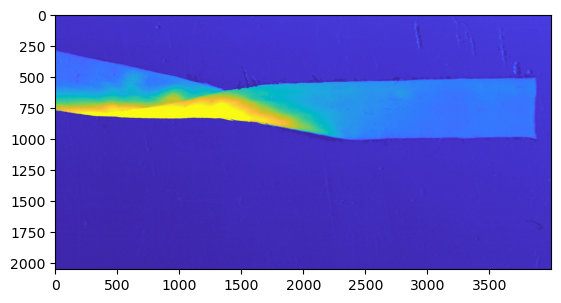

In [7]:
#choose image
test_case = image_list[5]


#get frames from the image
path_list = ['PuckerImages//RGB_cropped',
             'TwistImages//RGB',
             'FoldImages//RGB',]

print(f'Chosen image: {test_case}')
for path in path_list:
    if test_case[:4]==path[:4]:
        break        
img = Image.open(f'{path}//{test_case}')
image_data_gt = np.array(img, dtype=dtype)
#crop the end
image_data_gt = image_data_gt[:,:-96,:]
print(f'Image shape: {image_data_gt.shape}')
plt.imshow(image_data_gt)

In [8]:
frames_to_pred_total = 12

Stride: 160; predict: (6, 1, 0); repeat_prediction: 6; stateful: False


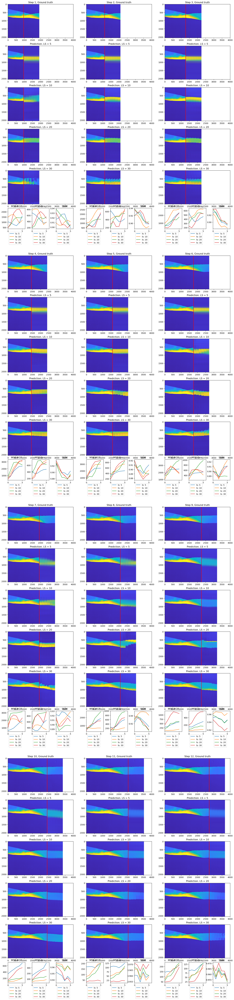

In [9]:
#load models
stride_step = stride_step_list[2]
window_size, window_size_predicted, overlap = sliding_window_settings_dict[stride_step][0]
stateful = False
repeat_prediction = 6
verbose = 0
print(f'Stride: {stride_step}; predict: {window_size, window_size_predicted, overlap}; repeat_prediction: {repeat_prediction}; stateful: {stateful}')

predicted_data_dict = {}

#get  ground truth frames
image_data_frames_gt = get_frames(image_data_gt, stride_step, ifPrint = False)

for unit_numb in unit_numb_list:
    lstm_pars_dict = {
        'stateful':stateful,
        'window_size':window_size,
        'window_size_predicted':window_size_predicted,
        'overlap':overlap    
    }

    #load models
    models_dict = load_models(unit_numb, stride_step, lstm_pars_dict)
    
    image_data_frames_list = predict_image(
        image_data_frames_gt, 
        models_dict,
        lstm_pars_dict, 
        repeat_prediction,
        verbose=verbose,
        frames_to_pred_total=frames_to_pred_total
    )
    
    predicted_data_dict[unit_numb] = image_data_frames_list
    
plot_prediction(
    image_data_frames_gt,
    predicted_data_dict,
    lstm_pars_dict,
    repeat_prediction,
    numb_cols=3
)

Stride: 160; predict: (4, 1, 0); repeat_prediction: 6; stateful: False


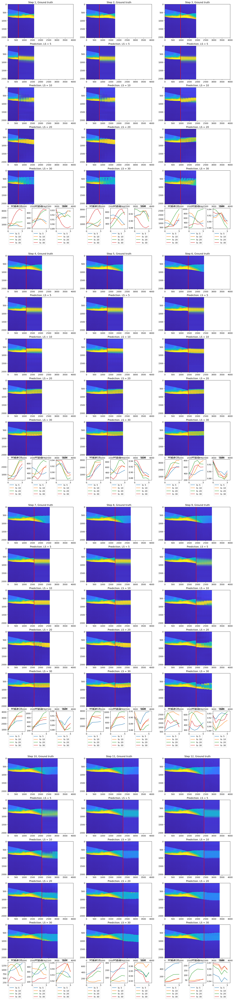

In [10]:
#load models
stride_step = stride_step_list[2]
window_size, window_size_predicted, overlap = sliding_window_settings_dict[stride_step][2]
stateful = False
repeat_prediction = 6
verbose = 0
print(f'Stride: {stride_step}; predict: {window_size, window_size_predicted, overlap}; repeat_prediction: {repeat_prediction}; stateful: {stateful}')

predicted_data_dict = {}

#get  ground truth frames
image_data_frames_gt = get_frames(image_data_gt, stride_step, ifPrint = False)

for unit_numb in unit_numb_list:
    lstm_pars_dict = {
        'stateful':stateful,
        'window_size':window_size,
        'window_size_predicted':window_size_predicted,
        'overlap':overlap    
    }

    #load models
    models_dict = load_models(unit_numb, stride_step, lstm_pars_dict)
    
    image_data_frames_list = predict_image(
        image_data_frames_gt, 
        models_dict,
        lstm_pars_dict, 
        repeat_prediction,
        verbose=verbose,
        frames_to_pred_total=frames_to_pred_total
    )
    
    predicted_data_dict[unit_numb] = image_data_frames_list
    
plot_prediction(
    image_data_frames_gt,
    predicted_data_dict,
    lstm_pars_dict,
    repeat_prediction,
    numb_cols=3
)

Stride: 160; predict: (6, 6, 3); repeat_prediction: 2; stateful: False


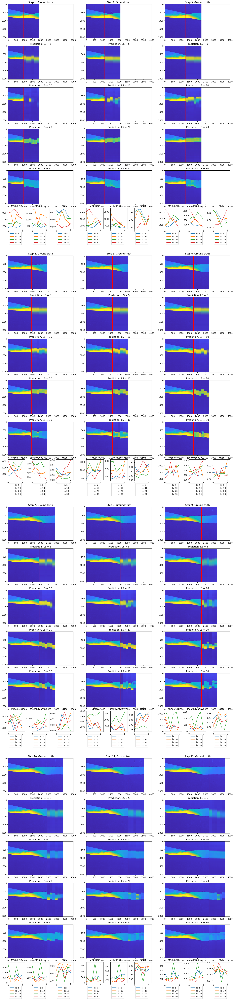

In [11]:
#load models
stride_step = stride_step_list[2]
window_size, window_size_predicted, overlap = sliding_window_settings_dict[stride_step][1]
stateful = False
repeat_prediction = 2
verbose = 0
print(f'Stride: {stride_step}; predict: {window_size, window_size_predicted, overlap}; repeat_prediction: {repeat_prediction}; stateful: {stateful}')

predicted_data_dict = {}

#get  ground truth frames
image_data_frames_gt = get_frames(image_data_gt, stride_step, ifPrint = False)

for unit_numb in unit_numb_list:
    lstm_pars_dict = {
        'stateful':stateful,
        'window_size':window_size,
        'window_size_predicted':window_size_predicted,
        'overlap':overlap    
    }

    #load models
    models_dict = load_models(unit_numb, stride_step, lstm_pars_dict)
    
    image_data_frames_list = predict_image(
        image_data_frames_gt, 
        models_dict,
        lstm_pars_dict, 
        repeat_prediction,
        verbose=verbose,
        frames_to_pred_total=frames_to_pred_total
    )
    
    predicted_data_dict[unit_numb] = image_data_frames_list
    
plot_prediction(
    image_data_frames_gt,
    predicted_data_dict,
    lstm_pars_dict,
    repeat_prediction,
    numb_cols=3
)

Stride: 160; predict: (4, 4, 2); repeat_prediction: 3; stateful: False


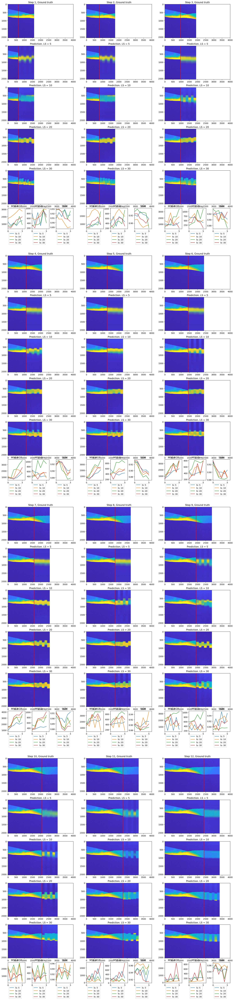

In [12]:
#load models
stride_step = stride_step_list[2]
window_size, window_size_predicted, overlap = sliding_window_settings_dict[stride_step][3]
stateful = False
repeat_prediction = 3
verbose = 0
print(f'Stride: {stride_step}; predict: {window_size, window_size_predicted, overlap}; repeat_prediction: {repeat_prediction}; stateful: {stateful}')

predicted_data_dict = {}

#get  ground truth frames
image_data_frames_gt = get_frames(image_data_gt, stride_step, ifPrint = False)

for unit_numb in unit_numb_list:
    lstm_pars_dict = {
        'stateful':stateful,
        'window_size':window_size,
        'window_size_predicted':window_size_predicted,
        'overlap':overlap    
    }

    #load models
    models_dict = load_models(unit_numb, stride_step, lstm_pars_dict)
    
    image_data_frames_list = predict_image(
        image_data_frames_gt, 
        models_dict,
        lstm_pars_dict, 
        repeat_prediction,
        verbose=verbose,
        frames_to_pred_total=frames_to_pred_total
    )
    
    predicted_data_dict[unit_numb] = image_data_frames_list
    
plot_prediction(
    image_data_frames_gt,
    predicted_data_dict,
    lstm_pars_dict,
    repeat_prediction,
    numb_cols=3
)